# **Project 3**
**PCA/SVD**

In this project we work on a [temperature dataset](https://berkeleyearth.org/data/) that reports the average earth surface temperature for different cities for each month over the years 1992-2006.

## Part 2: Applying PCA [2 Marks]

1. Compute the covariance matrix of the dataframe. *Hint: The dimensions of your covariance matrix should be (180, 180).* **[0.25]**
2. Write a function `get_sorted_eigen(df_cov)` that gets the covariance matrix of dataframe `df` (from step 1), and returns sorted eigenvalues and eigenvectors using `np.linalg.eigh`. **[0.25]**
3. Show the effectiveness of your principal components in covering the variance of the dataset with a `scree plot`. **[0.25]**
4. How many PCs do you need to cover 99% of the dataset's variance?

Need 9 PCs to cover 99% of the dataset's variance **[0.25]**
5. Plot the first 16 principal components (Eigenvectors) as a time series (16 subplots, on the x-axis you have dates and on the y-axis you have the value of the PC element) . **[0.5]**
6. Compare the first two PCs with the rest of them. Do you see any difference in their trend?

The first two principal components describe the two general trends in the temperature dataset. PC1 shows the oscillatory behaviour of the temperature, while PC2 illustrates the opposite version of PC1. These two principal components provide a high-level summary of the temperature trends in the dataset. Additionally, PC 3 captures the remaining oscillatory behaciour shown in the dataset. The rest of the PCs are basically noises that don't really have useful information **[0.5]**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
data_raw = pd.read_csv(
    filepath_or_buffer='https://raw.githubusercontent.com/Sabaae/Dataset/main/TemperaturesbyCity.csv',
    index_col=0
)
print('Setup complete')

Setup complete


In [2]:
data_raw.loc[['Yakeshi'],:] # show data

,1992-01-01,1992-02-01,1992-03-01,1992-04-01,1992-05-01,1992-06-01,1992-07-01,1992-08-01,1992-09-01,1992-10-01,...,2006-03-01,2006-04-01,2006-05-01,2006-06-01,2006-07-01,2006-08-01,2006-09-01,2006-10-01,2006-11-01,2006-12-01
City,,,,,,,,,,,,,,,,,,,,,
Yakeshi,-21.873,-18.478,-8.857,1.294,12.823,15.388,19.253,15.954,7.718,0.917,...,-10.867,-0.642,11.816,16.039,19.052,18.213,11.113,0.657,-13.114,-22.125


The shape of the covariance matrix is (180, 180)
The shape of eigenvalue is (180,)
The shape of eigenvector is (180, 180)


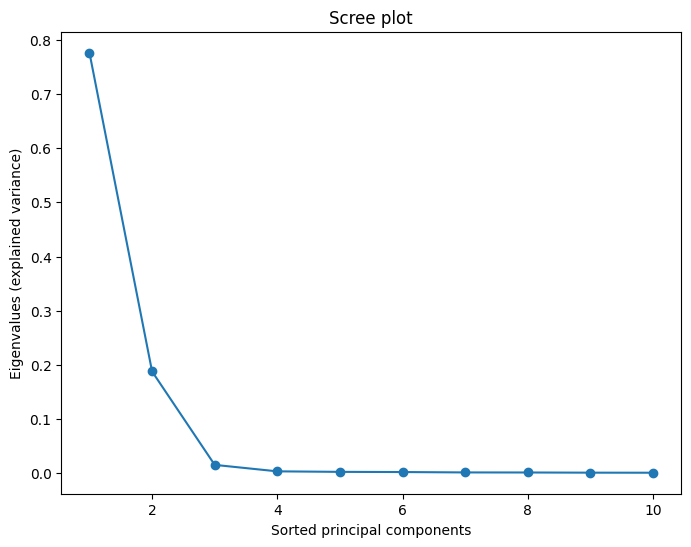

The number of PCs needed to cover 99% of the datasets variance is 9


In [3]:
### YOUR CODE HERE ###
num_mo = data_raw.shape[1] # get the number of months
data_std = data_raw.copy() # the data to be standardized
scalers = []  # to store scalers for each month
for i in range(num_mo):
  entry = data_std.iloc[:,i].values.reshape(-1, 1) # standardize each column
  scaler = StandardScaler()
  data_std.iloc[:,i] = scaler.fit_transform(entry).flatten()
  scalers.append(scaler)  # store the scaler

df_cov = data_std.cov() # get the covariance matrix
print('The shape of the covariance matrix is',df_cov.shape)

def get_sorted_eigen(df_cov):
  cov_matrix = df_cov.to_numpy()  # convert df to np array
  eigval, eigvec = np.linalg.eigh(cov_matrix) # compute eigenvalues and eigenvectors
  sorted_ind = np.argsort(eigval)[::-1] # sort eigenvalues and eigenvectors in descending order
  eigval = eigval[sorted_ind] # eigenvalue sorted
  eigvec = eigvec[:, sorted_ind] # eigenvector sorted
  return eigval,eigvec

eigval,eigvec = get_sorted_eigen(df_cov)
print('The shape of eigenvalue is',eigval.shape)
print('The shape of eigenvector is',eigvec.shape)

total_var = sum(eigval) # the total variance
exp_var = eigval / total_var # explained variance

plt.figure(figsize=(8, 6))
plt.plot(range(1, 10 + 1), exp_var[0:10],marker='o') # plot first 10 entries
plt.title('Scree plot')
plt.xlabel("Sorted principal components")
plt.ylabel("Eigenvalues (explained variance)")
plt.show()

cum_var = np.cumsum(exp_var) # cumulated sum

print('The number of PCs needed to cover 99% of the datasets variance is',np.argmax(cum_var >= 0.99) + 1)

In [4]:
# U, s, V = np.linalg.svd(data_std.to_numpy(), full_matrices=True)
# eigvec2 = V.T
# print(eigvec[:,0])
# print(eigvec2[:,0])

In [5]:
# print(data_std.shape)
# data_std_city = data_std.loc['Yakeshi'].to_frame()
# print(data_std_city.values.reshape(1,-1).shape)
# print(type(data_std_city))
# print(data_std_city.shape)
# df_city_cov = data_std_city.cov()
# print(df_city_cov.shape)


data_std_rec = np.dot(np.dot(data_std.to_numpy(), eigvec[:,:180]), eigvec[:,:180].T)
data_std_rec = pd.DataFrame(data_std_rec, index=data_raw.index, columns=data_raw.columns)

# data_inv_trans = data_std.iloc[:, :].values # Assuming you want to inverse transform all cities

# for i in range(num_mo): # Inverse transform for each month using the stored scalers
#   data_inv_trans[:, i] = scalers[i].inverse_transform(data_inv_trans[:, i].reshape(-1, 1)).flatten()

# data_inv_trans = pd.DataFrame(data_inv_trans, index=data_raw.index, columns=data_raw.columns)

city_inv_trans = data_std_rec.loc[['Yakeshi'], :].values.reshape(1, -1) # Assuming you want to inverse transform the first city (first row)

for i in range(num_mo): # Inverse transform for each month using the stored scalers
  city_inv_trans[:, i] = scalers[i].inverse_transform(city_inv_trans[:, i].reshape(-1, 1)).flatten()

city_inv_trans = pd.DataFrame(city_inv_trans, index=['Yakeshi'], columns=data_raw.columns)

In [6]:
# data_inv_trans.iloc[0:3,:]
print(city_inv_trans.loc['Yakeshi'].values.shape)

(180,)


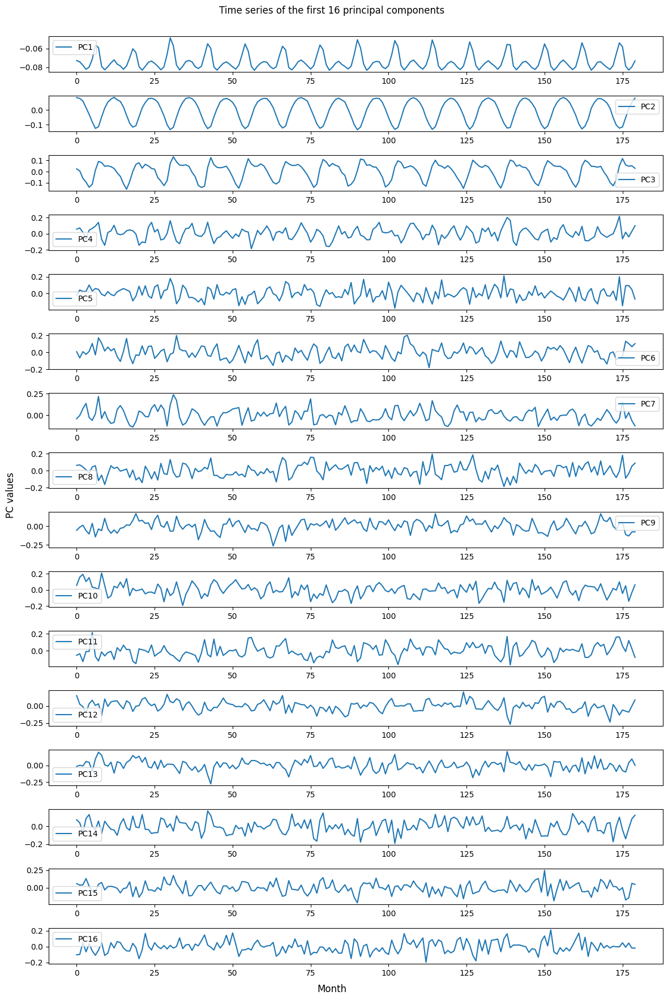

In [7]:
pc_values = eigvec # Get the principal components

time_points = np.arange(eigvec.shape[0]) # 180 months

fig, axes = plt.subplots(16, 1, figsize=(12, 18)) # Plot the first 16 principal components as time series
for i, ax in enumerate(axes):
  ax.plot(time_points, pc_values[:,i], label=f'PC{i + 1}')
  ax.legend()

fig.suptitle('Time series of the first 16 principal components')
fig.supxlabel('Month')
fig.supylabel('PC values')
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.show()

## Part 3: Data reconstruction [3 Marks]

Create a function that:

*   Accepts a city and the original dataset as inputs.
*   Calls useful functions that you designed in previous parts to compute eigenvectors and eigenvalues.
*   Plots 4 figures:
  1.   The original time-series for the specified city. **[0.5]**
  2.   The incremental reconstruction of the **original** (not standardized) time-series for the specified city in a single plot. **[1.5]**
       * You should at least show 5 curves in a figure for incremental reconstruction. For example, you can pick the following (or any other combination that you think is reasonable):
          * Reconstruction with only PC1
          * Reconstruction with both PC1 and PC2
          * Reconstruction with PC1 to PC4 (First 4 PCs)
          * Reconstruction with PC1 to PC8 (First 8 PCs)
          * Reconstruction with PC1 to PC16 (First 16 PCs)

      * Hint: you need to compute the reconstruction for the standardized time-series first, and then scale it back to the original (non-standardized form) using the StandardScaler `inverse_transform` [help...](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html#sklearn.preprocessing.StandardScaler.inverse_transform)

      * The 5 curves that I pick is:
          * Reconstruction with only PC1
          * Reconstruction with both PC1 and PC2
          * Reconstruction with PC1 to PC4 (First 4 PCs)
          * Reconstruction with PC1 to PC8 (First 8 PCs)
          * Reconstruction with PC1 to PC16 (First 16 PCs)

  3.   The residual error for your best reconstruction with respect to the original time-series. **[0.5]**
      * Hint: You are plotting the error that we have for reconstructing each month `(df - df_reconstructed)`. On the x-axis, you have dates, and on the y-axis, the residual error.
  4.   The RMSE of the reconstruction as a function of the number of included components (x-axis is the number of components and y-axis is the RMSE). Sweep x-axis from 1 to 10 (this part is independent from part 3.2.) **[1]**

Test your function using the `Yakeshi`, `Zamboanga`, `Norilsk`, `Juliaca`, and `Doha` as inputs. **[0.5]**


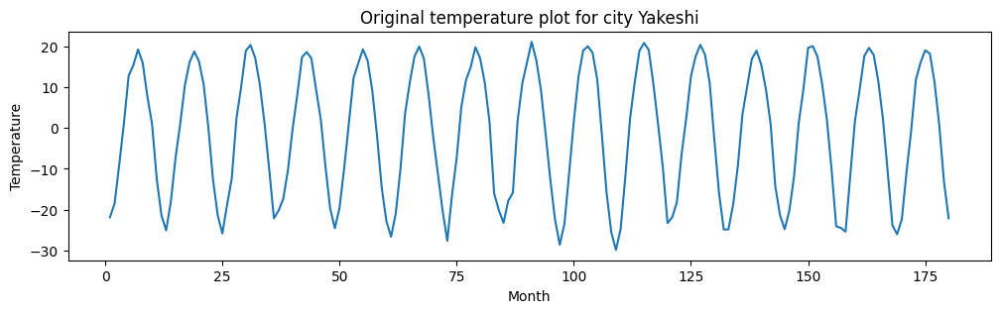

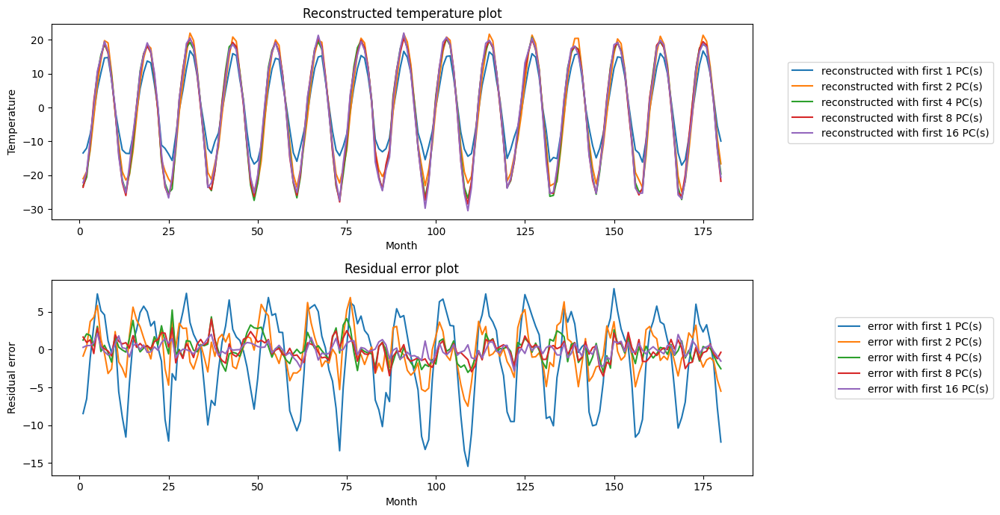

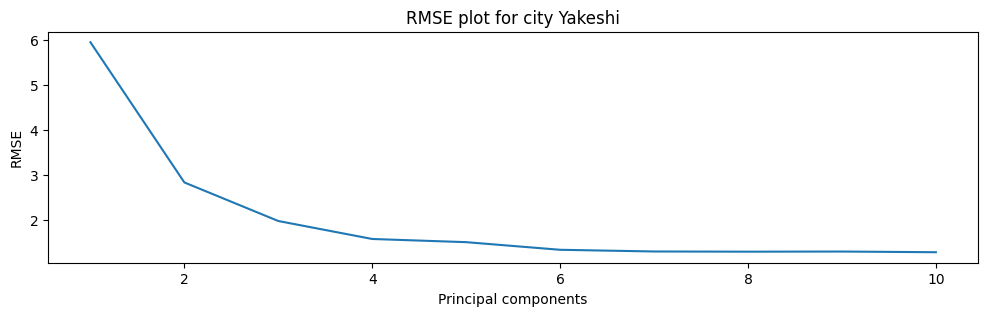

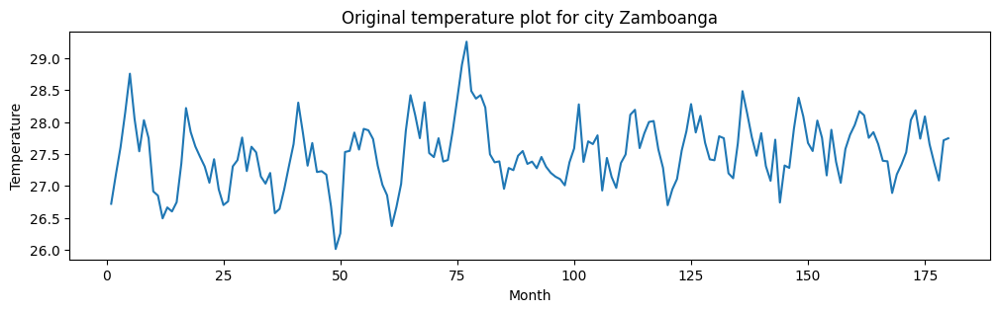

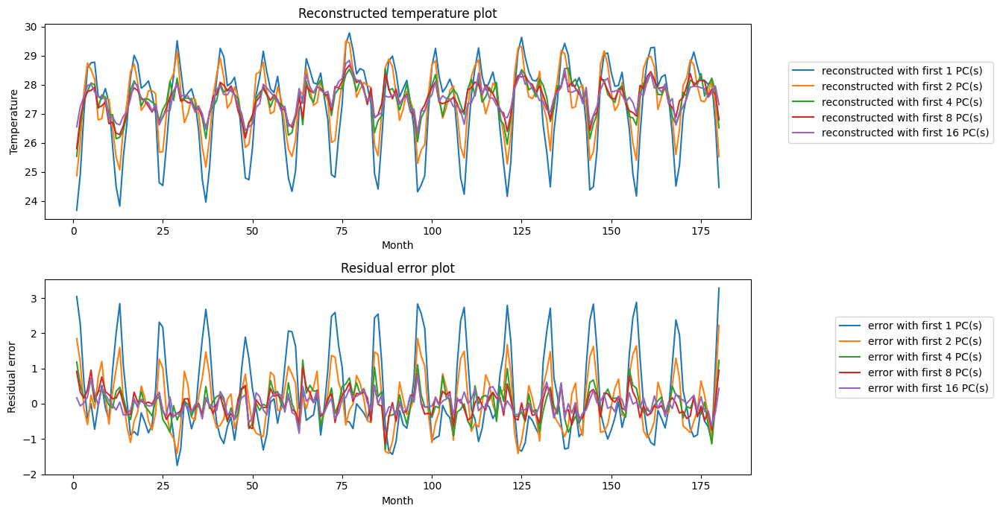

...

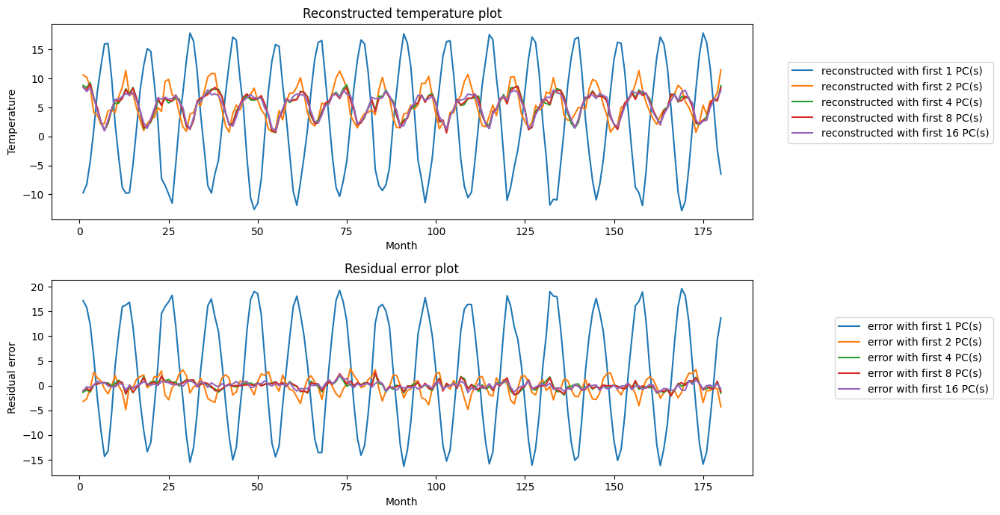

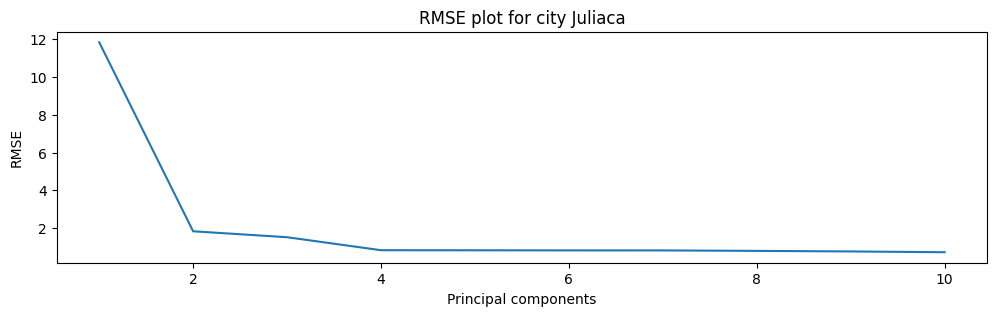

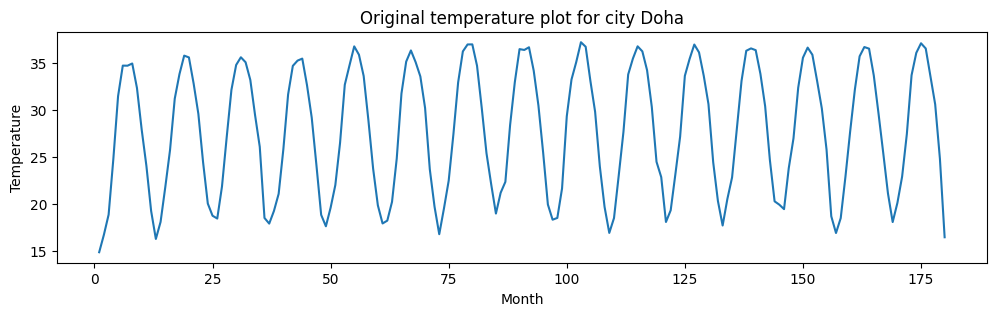

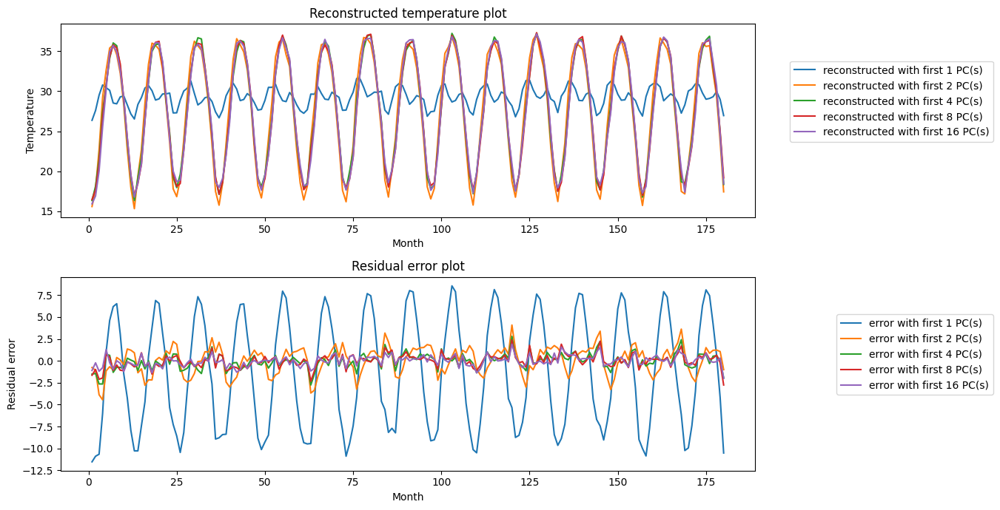

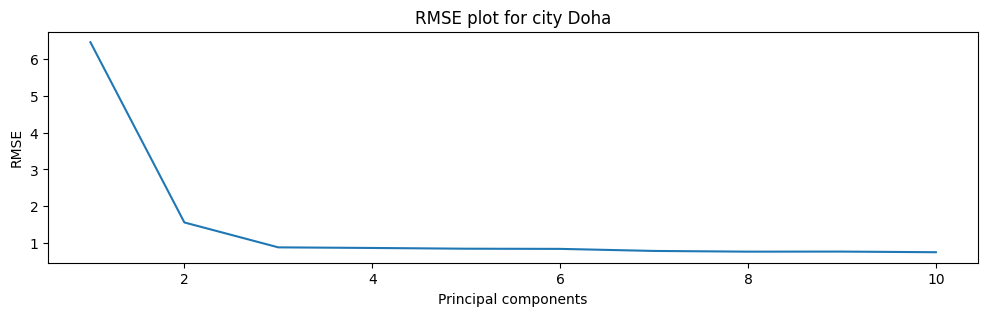

In [8]:
def plot_city_figures(original_df, city_name):
  ### YOUR CODE HERE ###
  data_raw = original_df
  city = city_name

  #1. The original time-series for the specified city
  fig, axes = plt.subplots(1, 1, figsize=(12, 3))
  axes.plot(range(1, data_raw.shape[1] + 1, 1), data_raw.loc[city])
  axes.set_title('Original temperature plot for city '+city)
  axes.set_ylabel('Temperature')
  axes.set_xlabel('Month')
  plt.show()

  num_mo = data_raw.shape[1] # get the number of months
  data_std = data_raw.copy() # the data to be standardized
  scalers = []  # to store scalers for each month
  for i in range(num_mo):
    entry = data_std.iloc[:,i].values.reshape(-1, 1) # standardize each column
    scaler = StandardScaler()
    data_std.iloc[:,i] = scaler.fit_transform(entry).flatten()
    scalers.append(scaler)  # store the scaler

  df_cov = data_std.cov() # get the covariance matrix
  eigval,eigvec = get_sorted_eigen(df_cov) # get the sorted eigenvalues and eigenvectors

  n_pc_list = [1,2,4,8,16] # first 1/2/4/8/16 principal components
  fig, axes = plt.subplots(2, figsize=(14, 7))
  for n, n_pc in enumerate(n_pc_list):
    data_std_rec = np.dot(np.dot(data_std.to_numpy(), eigvec[:,:n_pc]), eigvec[:,:n_pc].T) # reconstruction = X_raw * PC * PC.T , (m x n)(n x n_pc)(n_pc x n)
    data_std_rec = pd.DataFrame(data_std_rec, index=data_raw.index, columns=data_raw.columns)
    city_inv_trans = data_std_rec.loc[[city], :].values.reshape(1, -1) # inverse transform the city

    #2. The incremental reconstruction of the original (not standardized) time-series for the specified city in a single plot
    for i in range(num_mo): # Inverse transform for each month using the stored scalers
      city_inv_trans[:, i] = scalers[i].inverse_transform(city_inv_trans[:, i].reshape(-1, 1)).flatten()
    city_inv_trans = pd.DataFrame(city_inv_trans, index=[city], columns=data_raw.columns)

    axes[0].plot(range(1, data_raw.shape[1] + 1, 1), city_inv_trans.loc[city],label='reconstructed with first '+str(n_pc)+' PC(s)') # reconstruction with first N PCs
    axes[0].set_title('Reconstructed temperature plot')
    axes[0].set_ylabel('Temperature')
    axes[0].set_xlabel('Month')
    axes[0].legend(bbox_to_anchor = (1.35, 0.6), loc='center right')

    #3. The residual error for your best reconstruction with respect to the original time-series
    axes[1].plot(range(1, data_raw.shape[1] + 1, 1), data_raw.loc[city] - city_inv_trans.loc[city],label='error with first '+str(n_pc)+' PC(s)') # the residual errors corresponding to the principal components used for reconstruction
    axes[1].set_title('Residual error plot')
    axes[1].set_ylabel('Residual error')
    axes[1].set_xlabel('Month')
    axes[1].legend(bbox_to_anchor = (1.35, 0.6), loc='center right')
  # fig.suptitle('Reconstruction and residual error plots for city '+city)
  plt.tight_layout()
  plt.show()

  #4. The RMSE of the reconstruction as a function of the number of included components
  rmse_list = list(range(1,10+1,1))
  rmse = []
  for _,n_pc in enumerate(rmse_list):
    data_std_rec = np.dot(np.dot(data_std.to_numpy(), eigvec[:,:n_pc]), eigvec[:,:n_pc].T)
    data_std_rec = pd.DataFrame(data_std_rec, index=data_raw.index, columns=data_raw.columns)
    city_inv_trans = data_std_rec.loc[[city], :].values.reshape(1, -1) # inverse transform the city
    for i in range(num_mo): # Inverse transform for each month using the stored scalers
      city_inv_trans[:, i] = scalers[i].inverse_transform(city_inv_trans[:, i].reshape(-1, 1)).flatten()
    city_inv_trans = pd.DataFrame(city_inv_trans, index=[city], columns=data_raw.columns)
    y = data_raw.loc[city].values
    y_pred = city_inv_trans.loc[city].values
    rmse_val = np.sqrt(np.mean((y - y_pred) ** 2))
    rmse.append(rmse_val)
  fig, axes = plt.subplots(1, 1, figsize=(12, 3))
  axes.plot(rmse_list, rmse)
  axes.set_title('RMSE plot for city '+city)
  axes.set_ylabel('RMSE')
  axes.set_xlabel('Principal components')
  plt.show()

city_list = ['Yakeshi', 'Zamboanga', 'Norilsk', 'Juliaca', 'Doha'] # test on these cities
for city in city_list:
  plot_city_figures(data_raw, city)

## Part 4: SVD [2 Marks]
Modify your code in part 3 to use SVD instead of PCA for extracting the eigenvectors. **[1]**

see function "plot_city_figures_svd"

Explain if standardization or covariance computation is required for this part.
Repeat part 3 and compare your PCA and SVD results. Write a function to make this comparison **[0.5]**, and comment on the results. **[0.5]**.

As done in previous PCA cases, standardization is essential for SVD. In both SVD and PCA, the goal is to maximize variances. Having different scales in inputs could introduce bias into the model. Unlike PCA which needs a square covariance matrix to compute the eigen vectors, SVD does not require covariance computation as it naturally handles rectangular matrices and decompose the original matrix into u matrix, s matrix and v matrix.

According to the comparison results, SVD has the same performance as PCA. Additionally, the eigenvectors of the covariance matrix in PCA is equivalent to the right singular vectors (v matrix) in SVD, and the singular values in SVD are related to the eigenvalues of the covariance matrix in PCA. That could explain why these two method gives the same answer.

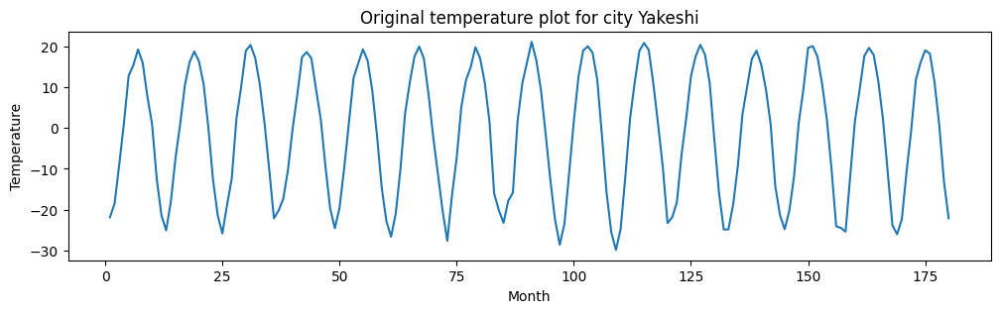

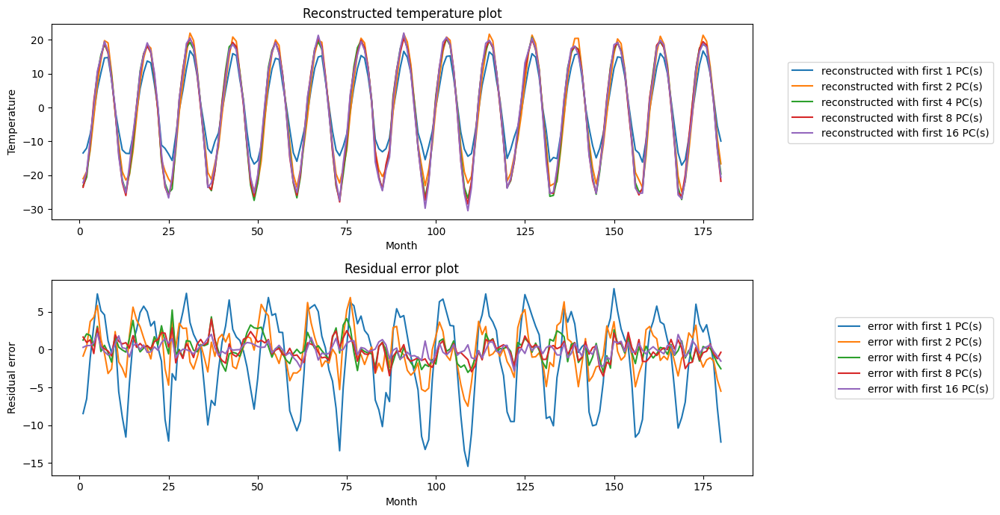

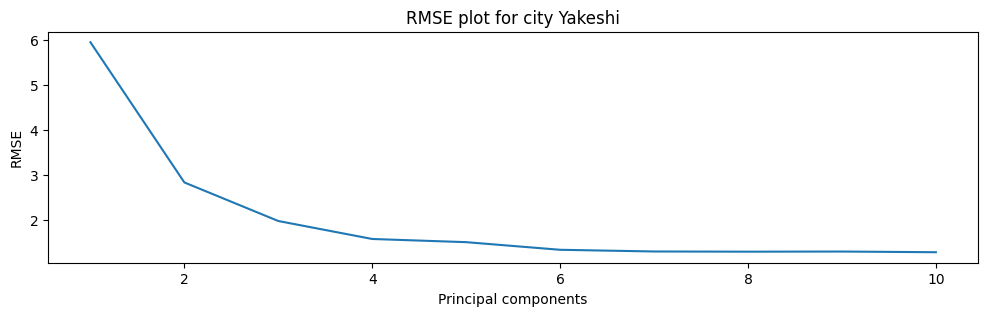

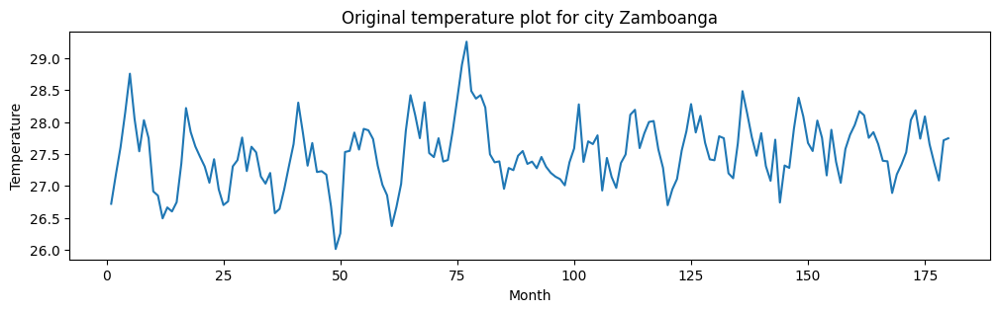

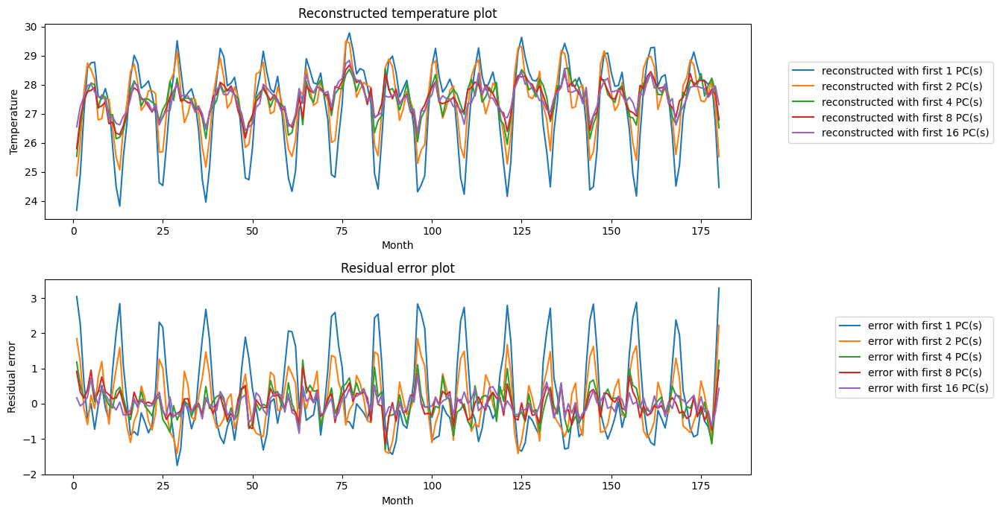

...

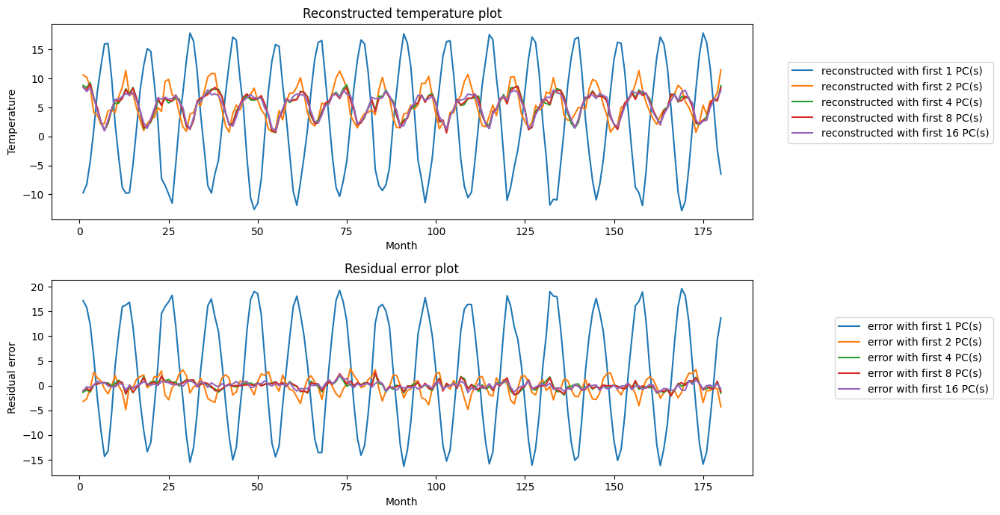

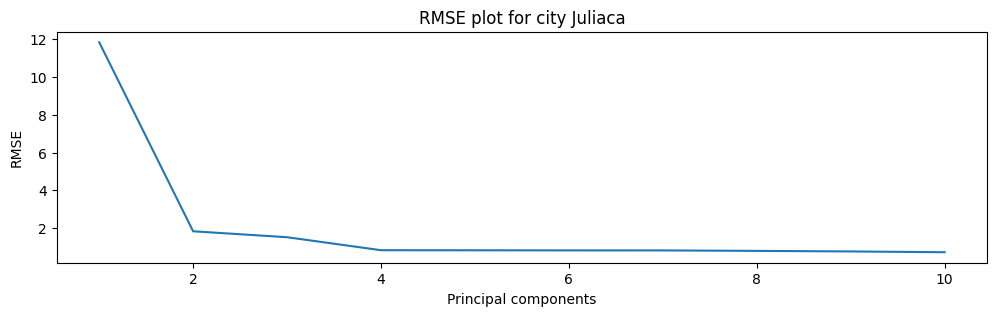

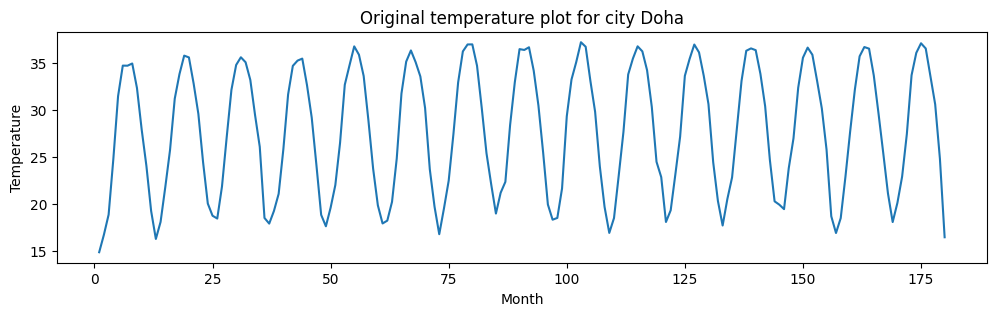

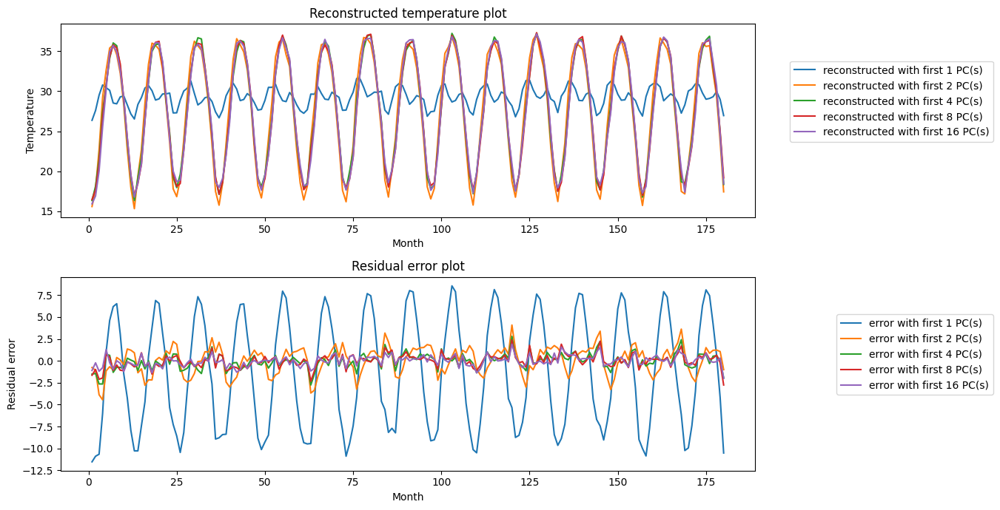

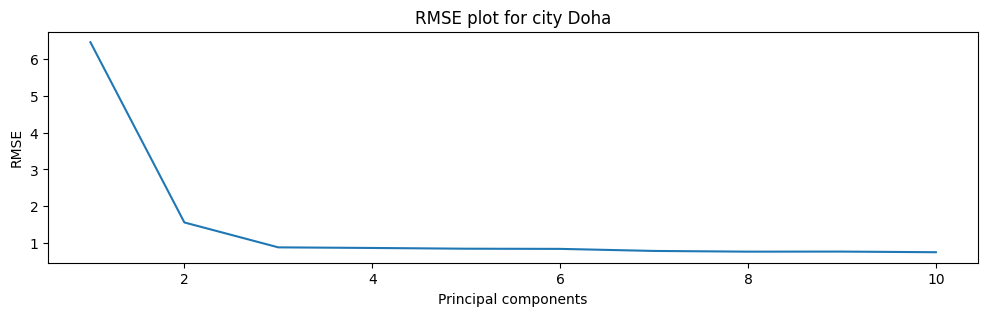

In [9]:
### YOUR CODE HERE ###
def plot_city_figures_svd(original_df, city_name):

  data_raw = original_df
  city = city_name

  #1. The original time-series for the specified city
  fig, axes = plt.subplots(1, 1, figsize=(12, 3))
  axes.plot(range(1, data_raw.shape[1] + 1, 1), data_raw.loc[city])
  axes.set_title('Original temperature plot for city '+city)
  axes.set_ylabel('Temperature')
  axes.set_xlabel('Month')
  plt.show()

  num_mo = data_raw.shape[1] # get the number of months
  data_std = data_raw.copy() # the data to be standardized
  scalers = []  # to store scalers for each month
  for i in range(num_mo):
    entry = data_std.iloc[:,i].values.reshape(-1, 1) # standardize each column
    scaler = StandardScaler()
    data_std.iloc[:,i] = scaler.fit_transform(entry).flatten()
    scalers.append(scaler)  # store the scaler

  u_mx, s_mx, v_mx = np.linalg.svd(data_std.to_numpy(), full_matrices=False) # get U, s, V matrix

  n_pc_list = [1,2,4,8,16] # first 1/2/4/8/16 principal components
  fig, axes = plt.subplots(2, figsize=(14, 7))
  for n, n_pc in enumerate(n_pc_list):
    data_std_rec = np.dot(np.dot(u_mx[:,:n_pc], np.diag(s_mx[:n_pc])), v_mx[:n_pc,:]) # reconstruction = U_r * s_r * PC.T, (m x n_pc)(n_pc x n_pc)(n_pc x n)
    data_std_rec = pd.DataFrame(data_std_rec, index=data_raw.index, columns=data_raw.columns)
    city_inv_trans = data_std_rec.loc[[city], :].values.reshape(1, -1) # inverse transform the city

    #2. The incremental reconstruction of the original (not standardized) time-series for the specified city in a single plot
    for i in range(num_mo): # Inverse transform for each month using the stored scalers
      city_inv_trans[:, i] = scalers[i].inverse_transform(city_inv_trans[:, i].reshape(-1, 1)).flatten()
    city_inv_trans = pd.DataFrame(city_inv_trans, index=[city], columns=data_raw.columns)

    axes[0].plot(range(1, data_raw.shape[1] + 1, 1), city_inv_trans.loc[city],label='reconstructed with first '+str(n_pc)+' PC(s)') # reconstruction with first N PCs
    axes[0].set_title('Reconstructed temperature plot')
    axes[0].set_ylabel('Temperature')
    axes[0].set_xlabel('Month')
    axes[0].legend(bbox_to_anchor = (1.35, 0.6), loc='center right')

    #3. The residual error for your best reconstruction with respect to the original time-series
    axes[1].plot(range(1, data_raw.shape[1] + 1, 1), data_raw.loc[city] - city_inv_trans.loc[city],label='error with first '+str(n_pc)+' PC(s)') # the residual errors corresponding to the principal components used for reconstruction
    axes[1].set_title('Residual error plot')
    axes[1].set_ylabel('Residual error')
    axes[1].set_xlabel('Month')
    axes[1].legend(bbox_to_anchor = (1.35, 0.6), loc='center right')
  # fig.suptitle('Reconstruction and residual error plots for city '+city)
  plt.tight_layout()
  plt.show()

  #4. The RMSE of the reconstruction as a function of the number of included components
  rmse_list = list(range(1,10+1,1))
  rmse = []
  for _,n_pc in enumerate(rmse_list):
    data_std_rec = np.dot(np.dot(u_mx[:,:n_pc], np.diag(s_mx[:n_pc])), v_mx[:n_pc,:])
    data_std_rec = pd.DataFrame(data_std_rec, index=data_raw.index, columns=data_raw.columns)
    city_inv_trans = data_std_rec.loc[[city], :].values.reshape(1, -1) # inverse transform the city
    for i in range(num_mo): # Inverse transform for each month using the stored scalers
      city_inv_trans[:, i] = scalers[i].inverse_transform(city_inv_trans[:, i].reshape(-1, 1)).flatten()
    city_inv_trans = pd.DataFrame(city_inv_trans, index=[city], columns=data_raw.columns)
    y = data_raw.loc[city].values
    y_pred = city_inv_trans.loc[city].values
    rmse_val = np.sqrt(np.mean((y - y_pred) ** 2))
    rmse.append(rmse_val)
  fig, axes = plt.subplots(1, 1, figsize=(12, 3))
  axes.plot(rmse_list, rmse)
  axes.set_title('RMSE plot for city '+city)
  axes.set_ylabel('RMSE')
  axes.set_xlabel('Principal components')
  plt.show()

city_list = ['Yakeshi', 'Zamboanga', 'Norilsk', 'Juliaca', 'Doha'] # test on these cities
for city in city_list:
  plot_city_figures_svd(data_raw, city)

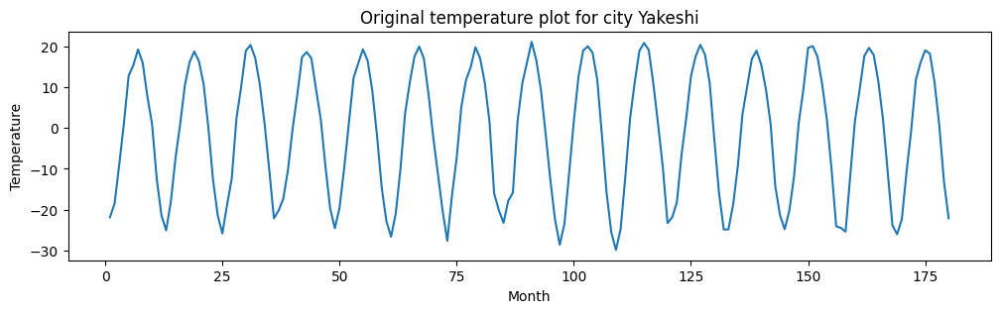

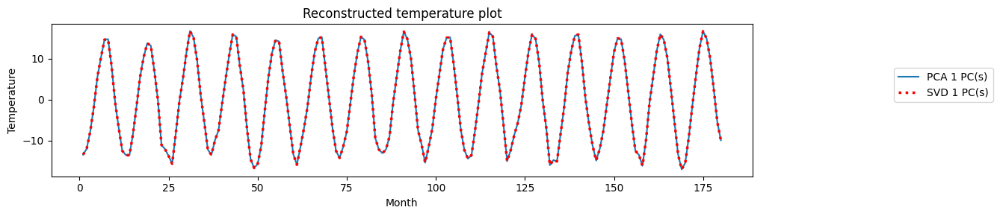

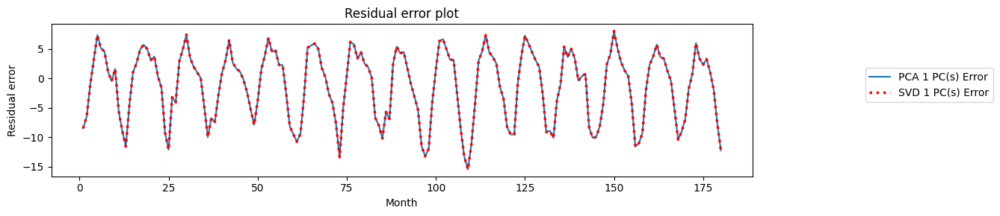

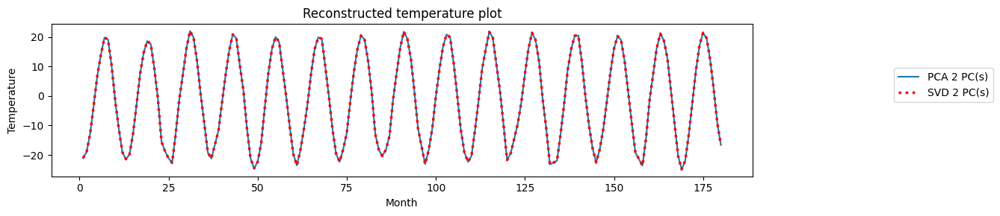

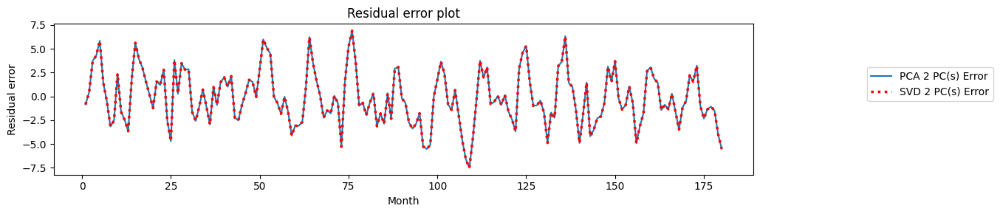

...

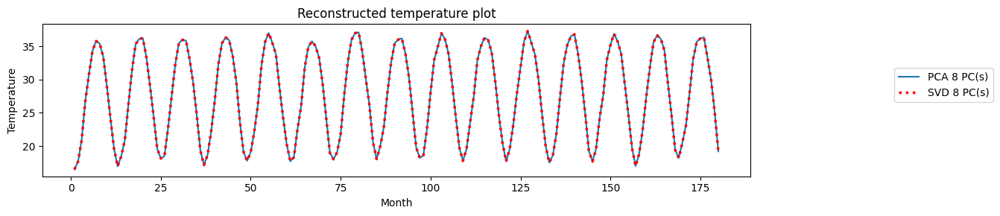

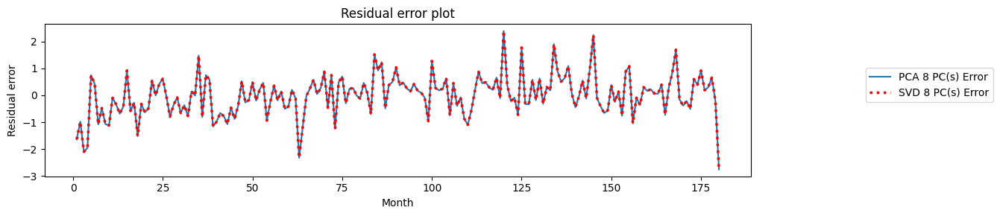

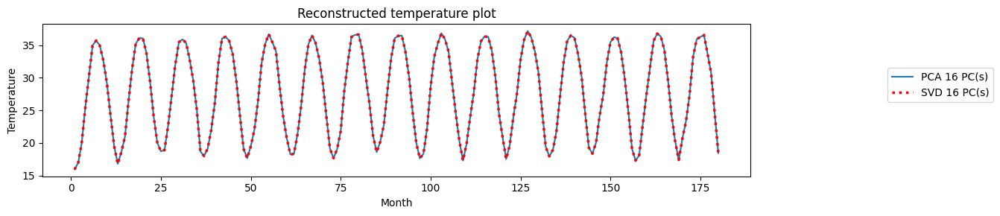

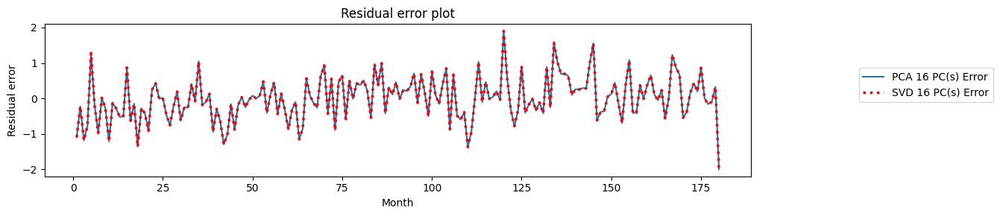

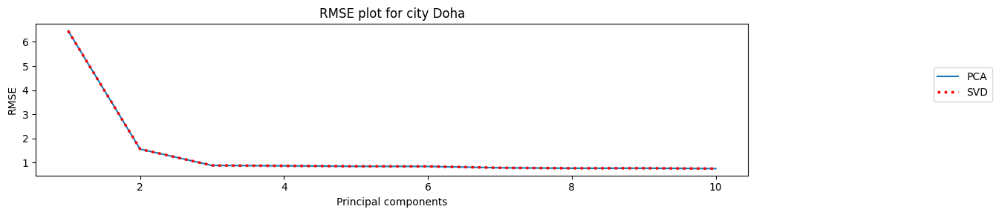

In [10]:
################################################################################
def compare_pca_svd(original_df, city_name):

  data_raw = original_df
  city = city_name

  #1. The original time-series for the specified city
  fig, axes = plt.subplots(1, 1, figsize=(12, 3))
  axes.plot(range(1, data_raw.shape[1] + 1, 1), data_raw.loc[city])
  axes.set_title('Original temperature plot for city '+city)
  axes.set_ylabel('Temperature')
  axes.set_xlabel('Month')
  plt.show()

  num_mo = data_raw.shape[1] # get the number of months
  data_std = data_raw.copy() # the data to be standardized
  scalers = []  # to store scalers for each month
  for i in range(num_mo):
    entry = data_std.iloc[:,i].values.reshape(-1, 1) # standardize each column
    scaler = StandardScaler()
    data_std.iloc[:,i] = scaler.fit_transform(entry).flatten()
    scalers.append(scaler)  # store the scaler
  #method 1: pca
  df_cov = data_std.cov() # get the covariance matrix
  eigval,eigvec = get_sorted_eigen(df_cov) # get the sorted eigenvalues and eigenvectors
  #method 2: svd
  u_mx, s_mx, v_mx = np.linalg.svd(data_std.to_numpy(), full_matrices=False) # get U, s, V matrix

  n_pc_list = [1,2,4,8,16] # first 1/2/4/8/16 principal components
  n_length = len(n_pc_list)

  for n, n_pc in enumerate(n_pc_list):
    data_std_rec_pca = np.dot(np.dot(data_std.to_numpy(), eigvec[:,:n_pc]), eigvec[:,:n_pc].T) # reconstruction = X_raw * PC * PC.T , (m x n)(n x n_pc)(n_pc x n)
    data_std_rec_pca = pd.DataFrame(data_std_rec_pca, index=data_raw.index, columns=data_raw.columns)
    city_inv_trans_pca = data_std_rec_pca.loc[[city], :].values.reshape(1, -1) # inverse transform the city

    data_std_rec_svd = np.dot(np.dot(u_mx[:,:n_pc], np.diag(s_mx[:n_pc])), v_mx[:n_pc,:]) # reconstruction = U_r * s_r * PC.T, (m x n_pc)(n_pc x n_pc)(n_pc x n)
    data_std_rec_svd = pd.DataFrame(data_std_rec_svd, index=data_raw.index, columns=data_raw.columns)
    city_inv_trans_svd = data_std_rec_svd.loc[[city], :].values.reshape(1, -1) # inverse transform the city

    #2. The incremental reconstruction of the original (not standardized) time-series for the specified city in a single plot
    for i in range(num_mo): # Inverse transform for each month using the stored scalers
      city_inv_trans_pca[:, i] = scalers[i].inverse_transform(city_inv_trans_pca[:, i].reshape(-1, 1)).flatten()
      city_inv_trans_svd[:, i] = scalers[i].inverse_transform(city_inv_trans_svd[:, i].reshape(-1, 1)).flatten()
    city_inv_trans_pca = pd.DataFrame(city_inv_trans_pca, index=[city], columns=data_raw.columns)
    city_inv_trans_svd = pd.DataFrame(city_inv_trans_svd, index=[city], columns=data_raw.columns)

    fig, axes = plt.subplots(1, 1, figsize=(14, 3))
    axes.plot(range(1, num_mo + 1, 1), city_inv_trans_pca.loc[city],label=f'PCA {n_pc} PC(s)') # reconstruction with first N PCs
    axes.plot(range(1, num_mo + 1, 1), city_inv_trans_svd.loc[city],label=f'SVD {n_pc} PC(s)',linestyle=':',linewidth=2.5,color='r') # reconstruction with first N PCs
    axes.set_title('Reconstructed temperature plot')
    axes.set_ylabel('Temperature')
    axes.set_xlabel('Month')
    axes.legend(bbox_to_anchor = (1.35, 0.6), loc='center right')
    plt.tight_layout()
    plt.show()

    #3. The residual error for your best reconstruction with respect to the original time-series
    fig, axes = plt.subplots(1, 1, figsize=(14, 3))
    axes.plot(range(1, num_mo + 1, 1), data_raw.loc[city] - city_inv_trans_pca.loc[city],label=f'PCA {n_pc} PC(s) Error') # the residual errors corresponding to the principal components used for reconstruction
    axes.plot(range(1, num_mo + 1, 1), data_raw.loc[city] - city_inv_trans_svd.loc[city],label=f'SVD {n_pc} PC(s) Error',linestyle=':',linewidth=2.5,color='r') # the residual errors corresponding to the principal components used for reconstruction
    axes.set_title('Residual error plot')
    axes.set_ylabel('Residual error')
    axes.set_xlabel('Month')
    axes.legend(bbox_to_anchor = (1.35, 0.6), loc='center right')
    plt.tight_layout()
    plt.show()

  #4. The RMSE of the reconstruction as a function of the number of included components
  rmse_list = list(range(1,10+1,1))
  rmse_pca = []
  rmse_svd = []
  for _,n_pc in enumerate(rmse_list):
    data_std_rec_pca = np.dot(np.dot(data_std.to_numpy(), eigvec[:,:n_pc]), eigvec[:,:n_pc].T)
    data_std_rec_pca = pd.DataFrame(data_std_rec_pca, index=data_raw.index, columns=data_raw.columns)
    city_inv_trans_pca = data_std_rec_pca.loc[[city], :].values.reshape(1, -1) # inverse transform the city

    data_std_rec_svd = np.dot(np.dot(u_mx[:,:n_pc], np.diag(s_mx[:n_pc])), v_mx[:n_pc,:])
    data_std_rec_svd = pd.DataFrame(data_std_rec_svd, index=data_raw.index, columns=data_raw.columns)
    city_inv_trans_svd = data_std_rec_svd.loc[[city], :].values.reshape(1, -1) # inverse transform the city

    for i in range(num_mo): # Inverse transform for each month using the stored scalers
      city_inv_trans_pca[:, i] = scalers[i].inverse_transform(city_inv_trans_pca[:, i].reshape(-1, 1)).flatten()
      city_inv_trans_svd[:, i] = scalers[i].inverse_transform(city_inv_trans_svd[:, i].reshape(-1, 1)).flatten()
    city_inv_trans_pca = pd.DataFrame(city_inv_trans_pca, index=[city], columns=data_raw.columns)
    city_inv_trans_svd = pd.DataFrame(city_inv_trans_svd, index=[city], columns=data_raw.columns)

    y = data_raw.loc[city].values
    y_pred_pca = city_inv_trans_pca.loc[city].values
    y_pred_svd = city_inv_trans_svd.loc[city].values
    rmse_val_pca = np.sqrt(np.mean((y - y_pred_pca) ** 2))
    rmse_val_svd = np.sqrt(np.mean((y - y_pred_svd) ** 2))
    rmse_pca.append(rmse_val_pca)
    rmse_svd.append(rmse_val_svd)
  fig, axes = plt.subplots(1, 1, figsize=(14, 3))
  axes.plot(rmse_list, rmse_pca, label='PCA')
  axes.plot(rmse_list, rmse_svd, label='SVD', linestyle=':',linewidth=2.5,color='r')
  axes.set_title('RMSE plot for city '+city)
  axes.set_ylabel('RMSE')
  axes.set_xlabel('Principal components')
  axes.legend(bbox_to_anchor = (1.35, 0.6), loc='center right')
  plt.tight_layout()
  plt.show()

city_list = ['Yakeshi', 'Zamboanga', 'Norilsk', 'Juliaca', 'Doha'] # test on these cities
for city in city_list:
  compare_pca_svd(data_raw, city)

## Part 5: Let's collect another dataset! [2 Marks]
Create another dataset similar to the one provided in your handout using the raw information on average temperatures per states (not cities) provided [here](https://github.com/Sabaae/Dataset/blob/main/TemperaturesbyState.csv). **[1]**

You need to manipulate the data to organize it in the desired format (i.e., the same format that was in previous parts). If there is a missing value for the average temperature of a particular state at a given date, make sure to remove that date completely from the dataset, even if the data of that specific date exists for other states.

You are free to use any tools you like, from Excel to Python! In the end, you should have a new CSV file with more dates (features) compared to the provided dataset. How many features does the final dataset have? How many states are there?


Upload your new dataset (in CSV format) to your colab notebook and repeat part 4. When analyzing the states, you may use `Jilin`, `Nunavut`, `Rio Grande Do Norte`, `Louisiana`, and `Tasmania`. **[1]**


The code below helps you to upload your new CSV file to your colab session.

In [11]:
# from google.colab import files # load train.csv to Google Colab
# uploaded = files.upload()
url = 'https://raw.githubusercontent.com/Sabaae/Dataset/main/TemperaturesbyState.csv'
data2 = pd.read_csv(url)

In [12]:
data2.loc[0:4,:]

,dt,AverageTemperature,AverageTemperatureUncertainty,State,Country
0,1963-01-01,26.037,0.315,Acre,Brazil
1,1963-01-01,-1.260,0.551,Adygey,Russia
2,1963-01-01,-22.297,0.563,Aga Buryat,Russia
3,1963-01-01,4.234,0.134,Alabama,United States
4,1963-01-01,26.389,0.540,Alagoas,Brazil


In [13]:
data2_raw = data2.pivot(index='State', columns='dt', values='AverageTemperature')

In [14]:
data2_raw.iloc[0:2,:]

dt,1963-01-01,1963-02-01,1963-03-01,1963-04-01,1963-05-01,1963-06-01,1963-07-01,1963-08-01,1963-09-01,1963-10-01,...,2012-12-01,2013-01-01,2013-02-01,2013-03-01,2013-04-01,2013-05-01,2013-06-01,2013-07-01,2013-08-01,2013-09-01
State,,,,,,,,,,,,,,,,,,,,,
Acre,26.037,25.659,25.506,26.019,25.675,25.097,25.382,27.432,27.706,27.393,...,26.318,26.587,26.318,26.386,26.398,26.034,26.033,24.807,25.378,NaN
Adygey,-1.260,2.380,1.506,8.992,15.204,17.843,22.220,21.487,17.756,10.716,...,0.191,0.621,3.661,4.812,11.363,18.222,20.221,21.937,22.087,NaN


In [15]:
### YOUR CODE HERE ###
data2_raw = data2_raw.dropna(axis=1) # drop the date column if it contains NaN

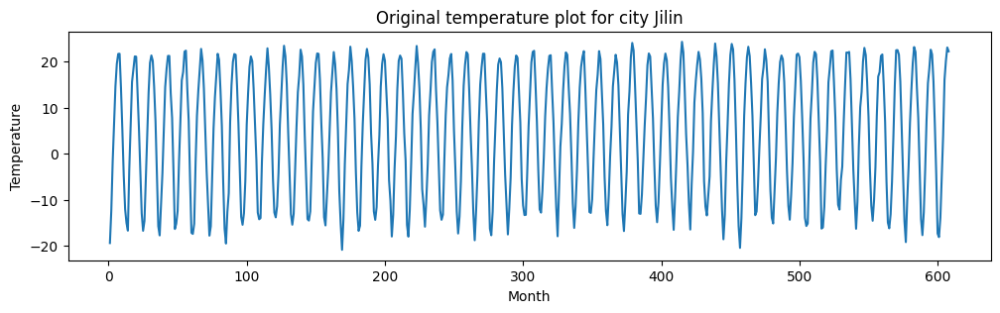

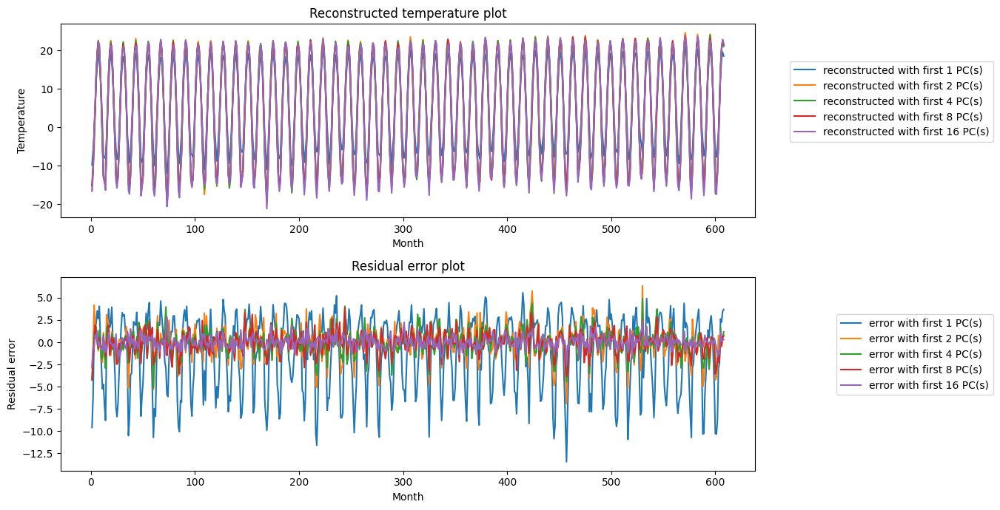

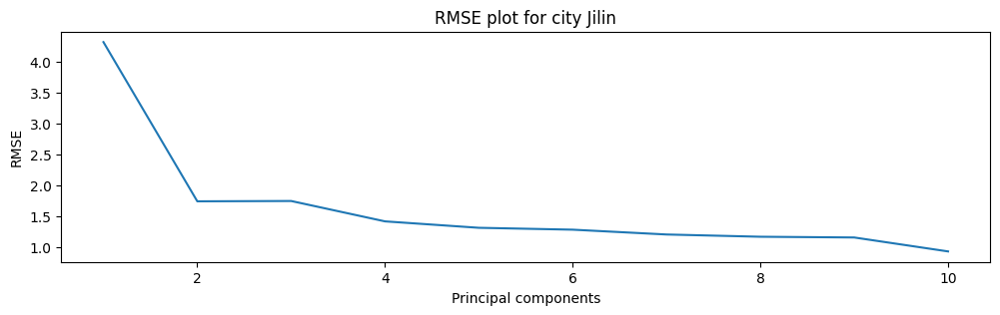

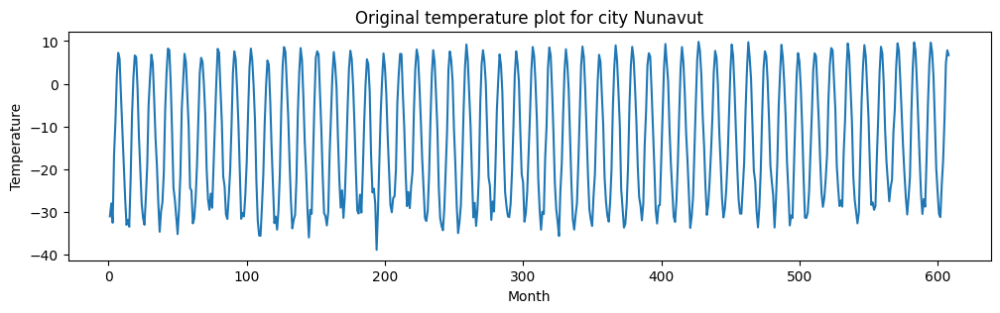

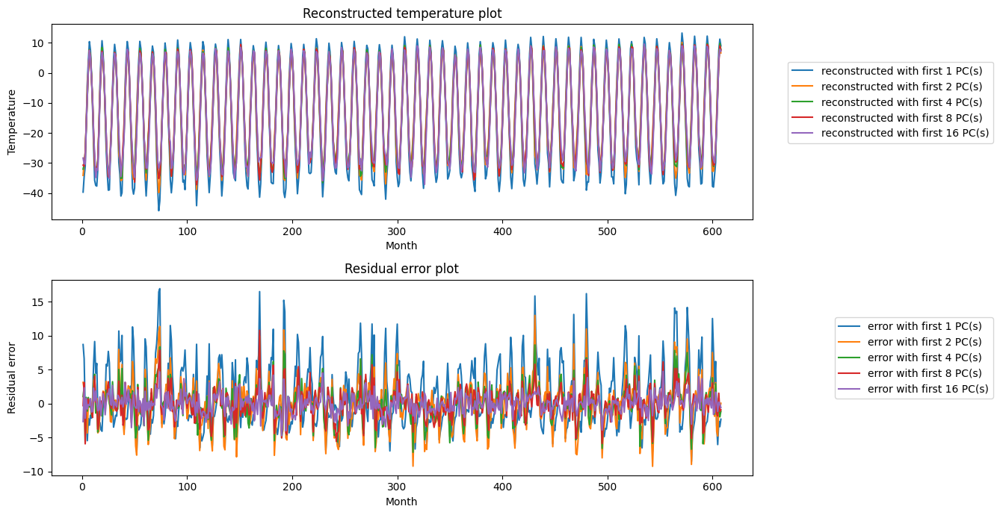

...

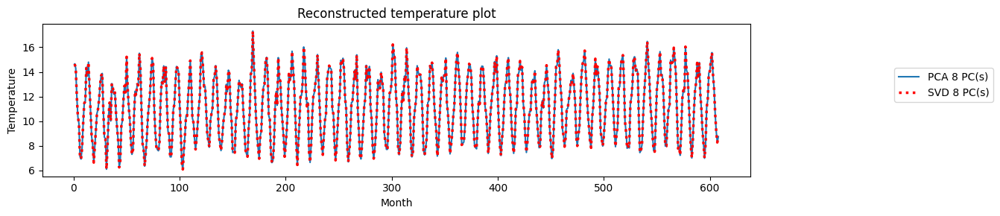

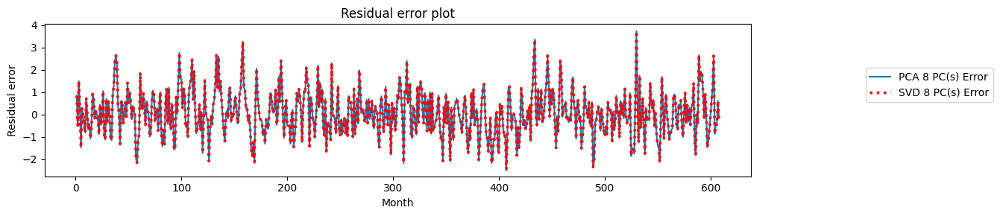

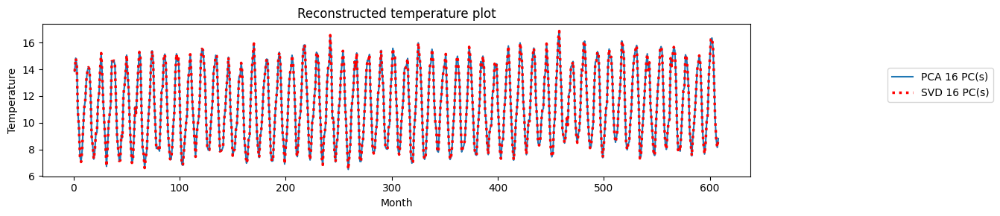

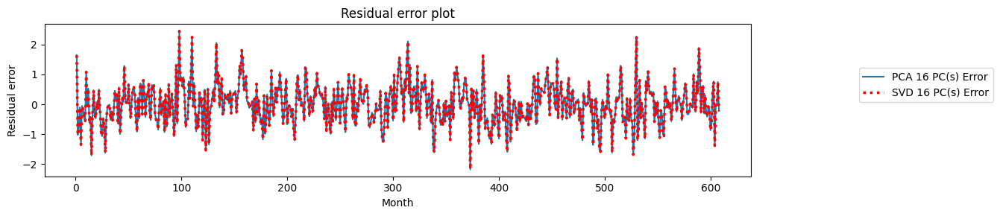

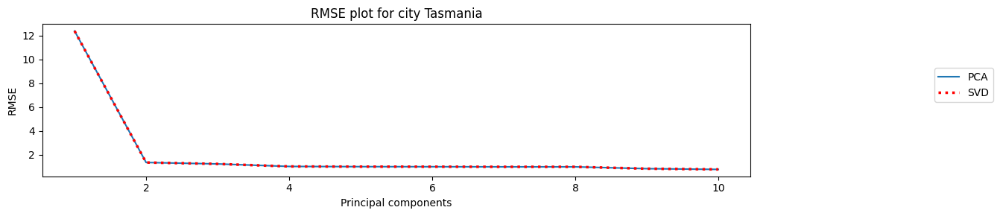

In [16]:
#repeat part 4
city_list = ['Jilin', 'Nunavut', 'Rio Grande Do Norte', 'Louisiana', 'Tasmania'] # test on these cities
for city in city_list:
  plot_city_figures_svd(data2_raw, city)

for city in city_list:
  compare_pca_svd(data2_raw, city)

# References

Understanding PCA and SVD:

1. https://towardsdatascience.com/pca-and-svd-explained-with-numpy-5d13b0d2a4d8

2. https://stats.stackexchange.com/questions/134282/relationship-between-svd-and-pca-how-to-use-svd-to-perform-pca

3. https://stats.stackexchange.com/questions/2691/making-sense-of-principal-component-analysis-eigenvectors-eigenvalues

4. https://hadrienj.github.io/posts/Deep-Learning-Book-Series-2.8-Singular-Value-Decomposition/

PCA:

1. Snippets from: https://plot.ly/ipython-notebooks/principal-component-analysis/

2. https://www.value-at-risk.net/principal-component-analysis/

Temperature Data:

1. https://www.kaggle.com/datasets/berkeleyearth/climate-change-earth-surface-temperature-data

2. https://berkeleyearth.org/data/

